In [12]:
import os
import numpy as np
from scipy.stats import gaussian_kde
import xarray as xr
import matplotlib.pyplot as plt
import pandas as pd
os.chdir('/home/ybhatti2/HPC_Jupyter/Python_Scripts/')
from my_functions import *
lats=xr.open_dataset('/home/ybhatti2/prjs1474/lats.nc').lat
lons=xr.open_dataset('/home/ybhatti2/prjs1474/lons.nc').lon


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Load data
df = pd.read_csv('~/prjs1076/yusufb/Branches/PPE_Project/PPE_Scripts/parameter_values_data/PPE_values.csv')
df.set_index(df.columns[0], inplace=True)

# Format: param_name: (vertex1, vertex2, aL, aR)
trapezoidal_param_config = {
    "SCALE_EMI_ANT_SO2":   (0.6, 1.4, 0, 1),
    "SCALE_EMI_ship_SO2":  (0.25, 1.75, 0, 2),
    "SCALE_EMI_ANT_BC":    (0.6, 1.4, 0, 1),
    "SCALE_EMI_ANT_OC":    (0.6, 1.4, 0, 1),
    "SCALE_EMI_BB_SO2":    (0.25, 2, 0, 1),
    "SCALE_EMI_BB_BC":     (0.25, 2, 0, 1),
    "SCALE_EMI_BB_OC":     (0.25, 2, 0, 1),
    "SCALE_EMI_SS_ACC":    (0.2, 2, 2, 1),
    "SCALE_EMI_SS_COARSE": (0.2, 2, 2, 1),
    "SCALE_EMI_CMR_BB":    (0.05e-6, 0.125e-6, 2, 1),
    "BC_RAD_NI":           (0.55, 0.85, 1, 4),
    "DU_RAD_NI":           (0.0002, 0.003, 0, 4),
    "SCALE_WETDEP_BC":     (0.5, 2, 2, 2),
    "SCALE_DRYDEP_ACC":    (0.1, 2, 0, 2),
    "SCALE_SO4_COATING":   (0.3, 2, 0, 1),
    "KAPPA_OC":            (0.02, 0.15, 0, 3),
    "SCALE_NUC_FT":        (0.1, 2, 0, 2)
}

# Number of parameters
n_params = df.shape[1]

# Grid layout
n_cols = int(n_params**0.5)
n_rows = -(-n_params // n_cols)  # ceiling division

fig, axes = plt.subplots(n_rows, n_cols, figsize=(22, 18))
axes = axes.flatten()

# Plot histograms with vertex 2 annotation
for i, col in enumerate(df.columns):
    axes[i].hist(df[col], bins=25, color="steelblue", edgecolor="black", alpha=0.75)
    axes[i].set_title(col, fontsize=16)
    axes[i].tick_params(axis="both", which="major", labelsize=17)

    # Axis labels
    axes[i].set_xlabel("Scale factor / perturbation", fontsize=14)
    axes[i].set_ylabel("Number of simulations", fontsize=14)

    # Annotate vertex2 if param in config
    if col in trapezoidal_param_config:
        v2 = trapezoidal_param_config[col][1]
        ymax = axes[i].get_ylim()[1]
        axes[i].axvline(v2, color="red", linestyle="--", linewidth=3)
        axes[i].text(
            v2*1.05, ymax*0.9, f"{v2:.3g}",
            rotation=0, va="top", ha="center", color="red", fontsize=14,fontweight="bold"
        )

# Remove unused axes
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.subplots_adjust(top=0.95)
fig.suptitle("Full LHC Parameter Distributions", fontsize=20, fontweight="bold")
plt.savefig("/home/ybhatti/prjs1076/Plots/Paper_2/Parameter_Distributions/Parameter_Distributions.png",dpi=100,bbox_inches = 'tight')

plt.show()


In [60]:
# PI = xr.open_mfdataset('/home/ybhatti2/prjs1474/Pace_PPE_Output/PPE_Experiments/PPE_Control_l_**01_achemon.nc')
# PD = xr.open_dataset('/home/ybhatti2/prjs1474/Pace_PPE_Output/PI_PPE_Experiments/PPE_Control_*.01_achemon.nc')
PI_SW = xr.open_mfdataset('/home/ybhatti2/prjs1474/Pace_PPE_Output/PI_PPE_Experiments/PPE_Control/PPE_Control_**01_echam.nc').srad0.mean('time').load()
PD_SW = xr.open_dataset('/home/ybhatti2/prjs1474/Pace_PPE_Output/PPE_Experiments/PPE_Control/PPE_Control_202404.01_echam.nc').srad0.mean('time').load()
PI_LW = xr.open_mfdataset('/home/ybhatti2/prjs1474/Pace_PPE_Output/PI_PPE_Experiments/PPE_Control/PPE_Control_**01_echam.nc').trad0.mean('time').load()
PD_LW = xr.open_dataset('/home/ybhatti2/prjs1474/Pace_PPE_Output/PPE_Experiments//PPE_Control/PPE_Control_202404.01_echam.nc').trad0.mean('time').load()
pd_rf = PD_SW + PD_LW
pi_rf = PI_SW + PI_LW

ERF_SW = PD_SW - PI_SW
ERF_LW = PD_LW - PI_LW 
ERF = (ERF_SW + ERF_LW)

ERF_Old = xr.open_mfdataset('/home/ybhatti2/ybhatti/prjs1076/Processed_Data/ERF_PPE.nc').__xarray_dataarray_variable__[0].load()

# PD_SW_Clear = PD.rsutnoa.mean('time')
# PD_LW_Clear = PD.rlutnoa.mean('time')
# PI_SW_Clear = PI.rsutnoa.mean('time').load()
# PI_LW_Clear = PI.rlutnoa.mean('time').load()

# PD_RF_Clear = PD_SW_Clear + PD_LW_Clear
# PD_RF = PD_SW + PD_LW
# PD_ari = PD_RF - PD_RF_Clear

# PI_RF_Clear = PI_SW_Clear + PI_LW_Clear
# PI_RF = PI_SW + PI_LW
# PI_ari = PI_RF - PI_RF_Clear
# ari = PD_ari - PI_ari


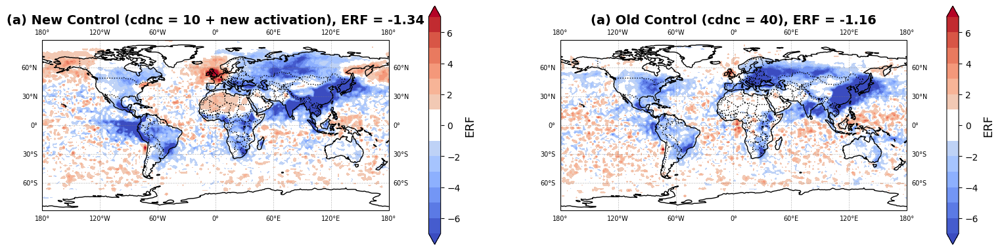

In [62]:
from matplotlib.colors import LinearSegmentedColormap
import cartopy.crs as ccrs
# Function to plot with colorbar (resized to fit subplot size)
def plot_with_colorbar(ax, data, lon, lat, cmap, clevs, title, Cbar_Title):
    img = plot_map(ax, data, lon, lat, cmap, clevs)  # Assuming plot_map returns an image
    cbar = plt.colorbar(img, ax=ax, orientation='vertical', fraction=0.03, pad=0.1)  # Increased pad
    cbar.ax.tick_params(labelsize=10)
    ax.set_title(title, fontsize=14, fontweight='bold')
    cbar.set_label(f'{Cbar_Title}',fontsize=13)
fig = plt.figure(figsize=(18, 12))

# Define grid for 3 rows, 3 columns with adjusted width ratios
grid = plt.GridSpec(1, 2, wspace=0.3, hspace=-0.3)

coolwarm_data_diff = plt.cm.coolwarm(np.linspace(0, 1, 256))
coolwarm_data_diff[110:146, :] = 1.0  # Set values from index 128 to 384 as white
coolwarm_white = LinearSegmentedColormap.from_list('coolwarm_white', coolwarm_data_diff)

# Map Subplots for AOD (POLDER, PPE Mean, Relative Uncertainty)
map_axes = [
    fig.add_subplot(grid[0, 0], projection=ccrs.PlateCarree()),  # POLDER AOD
    fig.add_subplot(grid[0, 1], projection=ccrs.PlateCarree()),  # POLDER AOD

]
clevs = np.arange(-7, 7 + 1, 1)  # Mean values
# Plot the selected maps
plot_with_colorbar(map_axes[0], ERF, lons, lats, coolwarm_white, clevs, 
                   f'(a) New Control (cdnc = 10 + new activation), ERF = {areaweight(ERF,lats):.2f}', 'ERF')

plot_with_colorbar(map_axes[1], ERF_Old, lons, lats, coolwarm_white, clevs, 
                   f'(a) Old Control (cdnc = 40), ERF = {areaweight(ERF_Old,lats):.2f}', 'ERF')


In [ ]:

path = xr.open_dataset('/projects/0/prjs1474/shared/PD_base_rad_3h_ml_20240501T000000Z.nc')
icon_tau335 = xr.open_dataset('/projects/0/prjs1474/shared/PD_base_rad_3h_ml_20240501T000000Z.nc').TAU355_355nm.mean('time').sum('height')
icon_tau550 = xr.open_dataset('/projects/0/prjs1474/shared/PD_base_rad_3h_ml_20240501T000000Z.nc').TAU_2D_550nm.mean('time')



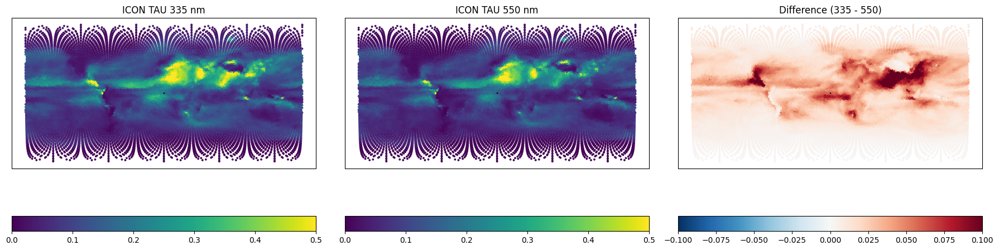

In [103]:
import numpy as np
import matplotlib.pyplot as plt
from math import log10, exp, log

# Set up common parameters
wind = np.arange(0, 25, 0.1)  # Wind speed range (m/s)
r = 0.5                       # Particle radius at 80% RH (µm)
Dp = 1.0                      # Dry particle diameter (µm)
SST = 10.0                    # Sea surface temperature (°C)

# Define all parameterization functions (from previous implementation)
def G03(u10, r):
    B = (0.433 - log10(r)) / 0.433
    term1 = 1.373 * (u10 ** 3.41) * (r ** -4)
    term2 = 1 + 0.057 * (r ** 3.45)
    term3 = 10 ** (1.607 * exp(-(B ** 2)))
    return term1 * term2 * term3

def MO86(u10, r):
    B = (0.433 - log10(r)) / 0.433
    term1 = 1.373 * (u10 ** 3.41) * (r ** -3)
    term2 = 1 + 0.057 * (r ** 1.05)
    term3 = 10 ** (1.19 * exp(-(B ** 2)))
    return term1 * term2 * term3

def MJ11(u10, r, SST):
    sst_factor = 0.3 + 0.1*SST - 0.0076*(SST**2) + 0.00021*(SST**3)
    return sst_factor * MO86(u10, r)

def GR14(u10, Dp, SST):
    sst_factor = 0.3 + 0.1*SST - 0.0076*(SST**2) + 0.00021*(SST**3)
    term1 = 235 * (u10**3.5) * exp(-0.55 * (log(Dp/0.1))**2)
    term2 = 0.2 * (u10**3.5) * exp(-1.5 * (log(Dp/3))**2)
    term3 = 6.8 * (u10**3.5) * exp(-1 * (log(Dp/30))**2)
    return sst_factor * (term1 + term2 + term3)

def JA11(u10, r, SST):
    sst_factor = 0.3 + 0.1*SST - 0.0076*(SST**2) + 0.00021*(SST**3)
    B = (0.433 - log10(r)) / 0.433
    term1 = 1.373 * (u10 ** 3.41) * (r ** -3)
    term2 = 1 + 0.057 * (r ** 1.05)
    term3 = 10 ** (1.07 * exp(-(B ** 2)))
    return sst_factor * term1 * term2 * term3

def LONG11(u10, Dp, SST, scale_seasalt_expo=1.0):
    """
    Long et al. (2011) sea salt emission parameterization with Sofiev (2011) SST correction
    as implemented in the Fortran code.
    
    Inputs:
        u10: Wind speed at 10m (m/s)
        Dp: Dry particle diameter (µm)
        SST: Sea surface temperature (°C)
        scale_seasalt_expo: Scaling factor for wind exponent (default=1.0)
    
    Returns:
        dF/dDp: Sea salt flux (#/m²/s/µm)
    """
    # Constants from the Fortran code
    ppww_long = 3.74
    ppww_long_scaled = ppww_long * scale_seasalt_expo
    p0 = 2.0e-8
    
    # Polynomial coefficients for different size ranges
    p11, p12, p13, p14 = 1.46, 1.33, -1.82, 8.83  # For Dp <= 1µm
    p21, p22, p23, p24 = -1.53, -0.081, -0.426, 8.84  # For Dp > 1µm
    
    # Convert SST from °C to Kelvin
    SST_K = SST + 273.15
    
    # Calculate base flux based on size range
    if Dp <= 1.0:  # dmtb_long = 1µm equivalent
        logDp = math.log10(Dp)
        p1 = p11*(logDp)**3 + p12*(logDp)**2 + p13*logDp + p14
        flux = (10.0**p1) * (p0 * u10**ppww_long_scaled)
    else:
        logDp = math.log10(Dp)
        p2 = p21*(logDp)**3 + p22*(logDp)**2 + p23*logDp + p24
        flux = (10.0**p2) * (p0 * u10**ppww_long_scaled)
    
    # Apply SST correction (Sofiev 2011)
    if SST_K <= 278.15:  # -2°C to +5°C
        SST_corr_1 = 0.13 * (Dp)**(-0.78)
        SST_corr_2 = 0.22 * (Dp)**(-0.70)
        SST_corr = (SST_corr_1*(278.15 - SST_K) + SST_corr_2*(SST_K - 271.15))/7.0
    elif 278.15 < SST_K <= 288.15:  # +5°C to +15°C
        SST_corr_1 = 0.22 * (Dp)**(-0.70)
        SST_corr_2 = 0.70 * (Dp)**(-0.18)
        SST_corr = (SST_corr_1*(288.15 - SST_K) + SST_corr_2*(SST_K - 278.15))/10.0
    elif SST_K > 288.15:  # > +15°C
        SST_corr_1 = 0.70 * (Dp)**(-0.18)
        SST_corr_2 = 1.45 * (Dp)**(0.18)
        SST_corr = (SST_corr_1*(298.15 - SST_K) + SST_corr_2*(SST_K - 288.15))/10.0
    
    # Apply correction (comment out to remove SST dependence)
    flux *= SST_corr
    
    return flux
    
# Calculate fluxes for each parameterization
g03_flux = [G03(w, r) for w in wind]
mo86_flux = [MO86(w, r) for w in wind]
mj11_flux = [MJ11(w, r, SST) for w in wind]
gr14_flux = [GR14(w, Dp, SST) for w in wind]
ja11_flux = [JA11(w, r, SST) for w in wind]



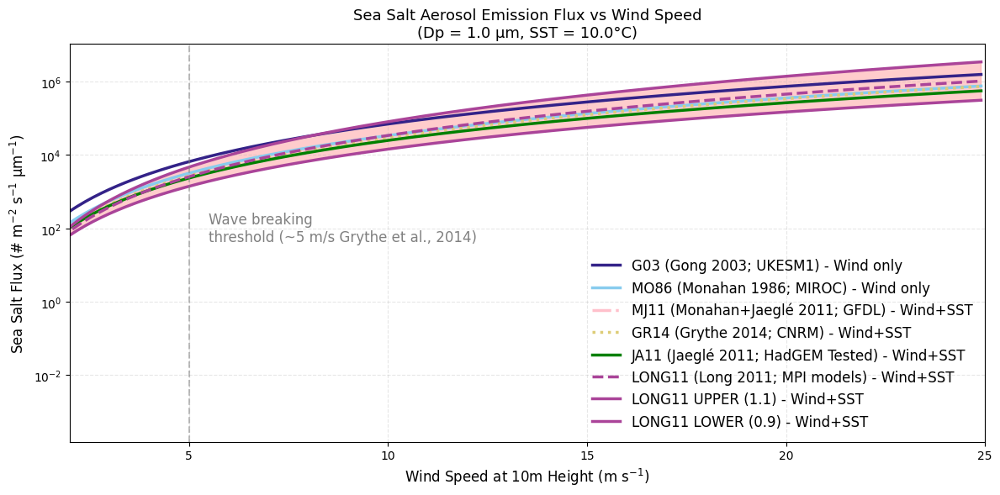

In [126]:
import numpy as np
import matplotlib.pyplot as plt

# Wind speed array
wind = np.arange(0, 25, 0.1)

# Parameters
r = 0.5       # µm at 80% RH
Dp = 1.0      # µm dry diameter
SST = 10.0     # °C

# Flux calculations (assuming your functions G03, MO86, etc. are defined)
g03_flux = [G03(w, r) for w in wind]
mo86_flux = [MO86(w, r) for w in wind]
mj11_flux = [MJ11(w, r, SST) for w in wind]
gr14_flux = [GR14(w, Dp, SST) for w in wind]
ja11_flux = [JA11(w, r, SST) for w in wind]
long11_flux = [LONG11(w, Dp, SST) for w in wind]
long11_flux_upper = [LONG11(w, Dp, SST, 1.1) for w in wind]
long11_flux_lower = [LONG11(w, Dp, SST, 0.9) for w in wind]

# Initialize figure and axes
fig = plt.figure(figsize=(12, 6))
axe = fig.add_subplot(1, 1, 1)

# Plotting styles
colors = ['#332288', '#88CCEE', 'pink', '#DDCC77', 'green', '#AA4499', '#AA4499', '#AA4499']
linestyles = ['-', '-', '-.', ':', '-', '--', '-', '-']
labels = [
    'G03 (Gong 2003; UKESM1) - Wind only',
    'MO86 (Monahan 1986; MIROC) - Wind only',
    'MJ11 (Monahan+Jaeglé 2011; GFDL) - Wind+SST',
    'GR14 (Grythe 2014; CNRM) - Wind+SST',
    'JA11 (Jaeglé 2011; HadGEM Tested) - Wind+SST',
    'LONG11 (Long 2011; MPI models) - Wind+SST',
    'LONG11 UPPER (1.1) - Wind+SST',
    'LONG11 LOWER (0.9) - Wind+SST'
]

fluxes = [
    g03_flux, mo86_flux, mj11_flux, gr14_flux,
    ja11_flux, long11_flux, long11_flux_upper, long11_flux_lower
]

# Plot all lines
for flux, color, ls, label in zip(fluxes, colors, linestyles, labels):
    axe.plot(wind, flux, color=color, linestyle=ls, linewidth=2.5, label=label)

# Add shaded uncertainty band for LONG11
axe.fill_between(wind, long11_flux_lower, long11_flux_upper, color='red', alpha=0.2)

# Wave-breaking threshold
axe.axvline(x=5, color='gray', linestyle='--', alpha=0.5)
axe.text(5.5, 1e2, 'Wave breaking\nthreshold (~5 m/s Grythe et al., 2014)',
         va='center', color='gray', fontsize=12)

# Axis settings
axe.set_yscale('log')
axe.set_xlim([2, 25])
axe.set_xlabel('Wind Speed at 10m Height (m s$^{-1}$)', fontsize=12)
axe.set_ylabel('Sea Salt Flux (# m$^{-2}$ s$^{-1}$ µm$^{-1}$)', fontsize=12)
axe.set_title(f'Sea Salt Aerosol Emission Flux vs Wind Speed\n(Dp = {Dp} µm, SST = {SST}°C)', fontsize=13)
axe.legend(fontsize=12, frameon=False)
axe.grid(True, which="both", linestyle="--", alpha=0.3)

plt.tight_layout()
#plt.show()
plt.savefig("/home/ybhatti/prjs1076/Plots/Paper_2/Seasalt_PPE_Range.png", dpi=300)


In [2]:
import numpy as np
from scipy.stats import pearsonr
from sklearn.metrics.pairwise import cosine_similarity
import xarray as xr

def compare_spatial_similarity(data1: xr.DataArray, data2: xr.DataArray):
    """
    Compare two spatial xarray DataArrays using:
      - Pearson correlation
      - Cosine similarity
      - Normalized RMSE

    Parameters:
    ----------
    data1 : xr.DataArray
        First spatial dataset (must be 2D: lat x lon).
    data2 : xr.DataArray
        Second spatial dataset (same shape as data1).

    Returns:
    -------
    dict
        {
            "pearson": float,
            "cosine": float,
            "nrmse": float
        }
    """
    # Flatten and mask NaNs
    a = data1.values.flatten()
    b = data2.values.flatten()
    mask = np.isfinite(a) & np.isfinite(b)
    a = a[mask]
    b = b[mask]

    if len(a) == 0 or len(b) == 0:
        raise ValueError("No valid data points to compare after masking NaNs.")

    # Pearson correlation
    pearson_corr, _ = pearsonr(a, b)

    # Cosine similarity
    cos_sim = cosine_similarity([a], [b])[0, 0]

    # Normalized RMSE (relative to mean magnitude)
    rmse = np.sqrt(np.mean((a - b) ** 2))
    nrmse = rmse / (np.mean(a) + np.mean(b))

    return {
        "pearson": pearson_corr,
        "cosine": cos_sim,
        "nrmse": nrmse
    }


In [4]:
import xarray as xr
from pathlib import Path
dms_ppt=(29/62.13)*1e9 # molecular mass of air (g/mol). molecular mass of DMS (g/mol).
so2_ppt=(29/64.066)*1e9 # ppb
h2so4_ppb=(29/98.079)*1e9 # ppb

# Base path
base = Path("/home/ybhatti/prjs1076/PPE_Output/PPE_Experiments")
base = Path("/home/ybhatti/prjs1076/PPE_Output/Pace_PPE_Experiments")

# Folder names
#experiments = ["SSA_Coarse", "SSA_ACC", "DMS_Chem_High", "Control","Activation_Sulfate_Chem_High", "Sulfate_Chem_High","Sulfate_AQ_chem_high"]
experiments = ["Activate_DMS_so2_fraction_low","Activate_DMS_so2_fraction","Activate_DMS_Chem_Low", "Activate_DMS_Chem_High","Activate_DMS_Emissions",
               "Activate_DMS_Emissions_Low", "Activate_Control","Control","SSA_Coarse", "SSA_ACC","Activate_SSA_Expo","Activate_SS_Emissions"
               ]
experiments = ["Activate_DMS_so2_fraction_low", "Activate_DMS_so2_fraction", "Control_1_month",
               "Activate_DMS_Chem_HIGH","Activate_DMS_Chem_Low",
              "Sulfate_Chem_High","Sulfate_Chem_Low","Activate_DMS_Emissions_1_month",
               "Activate_SS_Acc","Activate_SS_Coarse","Activate_Control","Activate_SS_Acc_low",
              "Activate_SS_Acc_NO"]
#experiments = ["Control_1_month", "DMS_so2_fraction_1_month", "DMS_so2_fraction_low_1_month"]

# Open each variable from the corresponding files
#cdnc_ct_datasets = [xr.open_dataset(base / f / f"{f}_200909.01_hifreq_monthly.nc")["CDNC_CT"] for f in experiments]
#cdnc_ct_datasets = [xr.open_dataset(base / f / f"{f}_200909.01_hifreq_monthly.nc")["CDNC_CT"] for f in experiments]
ccn_ct_datasets = [xr.open_dataset(base / f / f"{f}_200909.01_hifreq.nc")["CCN_1.500"] for f in experiments]
#cdnc_ct_datasets = [xr.open_dataset(base / f / f"{f}_200909.01_hifreq.nc")["CDNC_INCL_CT"] for f in experiments]

tau_datasets     = [xr.open_dataset(base / f / f"{f}_200909.01_hifreq.nc")["TAU_2D_550nm"] for f in experiments]
ANG_datasets     = [xr.open_dataset(base / f / f"{f}_200909.01_hifreq.nc")["ANG_440nm_670nm"] for f in experiments]

cdnc_acc_datasets = [xr.open_dataset(base / f / f"{f}_200909.01_activ.nc")["CDNC_ACC"] for f in experiments]
#AE_datasets = [xr.open_dataset(base / f / f"{f}_200909.01_rad.nc")["ANG_550nm_865nm"] for f in experiments]
DMS_Burden_datasets = [xr.open_dataset(base / f / f"{f}_200909.01_burden.nc")["burden_DMS"] for f in experiments]
SO2_Burden_datasets = [xr.open_dataset(base / f / f"{f}_200909.01_burden.nc")["burden_SO2"] for f in experiments]
H2SO4_Burden_datasets = [xr.open_dataset(base / f / f"{f}_200909.01_burden.nc")["burden_H2SO4"] for f in experiments]
coarse_datasets     = [xr.open_dataset(base / f / f"{f}_200909.01_hifreq.nc")["TAU_MODE_CS_550nm"] for f in experiments]
acc_datasets     = [xr.open_dataset(base / f / f"{f}_200909.01_hifreq.nc")["TAU_MODE_AS_550nm"] for f in experiments]
ssa_emi_datasets     = [xr.open_dataset(base / f / f"{f}_200909.01_emi.nc")["emi_SS"] for f in experiments]
ssa_burden_datasets     = [xr.open_dataset(base / f / f"{f}_200909.01_burden.nc")["burden_SS"] for f in experiments]
ssa_aod_datasets     = [xr.open_dataset(base / f / f"{f}_200909.01_rad.nc")["TAU_COMP_SS_550nm"] for f in experiments]
ssa_coarse_datasets     = [xr.open_dataset(base / f / f"{f}_200909.01_tracer.nc")["SS_CS"] for f in experiments]
ssa_accum_datasets     = [xr.open_dataset(base / f / f"{f}_200909.01_tracer.nc")["SS_AS"] for f in experiments]
water_aod_datasets     = [xr.open_dataset(base / f / f"{f}_200909.01_rad.nc")["TAU_COMP_WAT_550nm"] for f in experiments]

# Stack CDNC_CT variables into one DataArray
#cdnc_ct_4d = xr.concat(cdnc_ct_datasets, dim=xr.DataArray(experiments, dims="experiment")).mean('time')/1000000
cdnc_acc_4d = xr.concat(cdnc_acc_datasets, dim=xr.DataArray(experiments, dims="experiment")).mean('time')[:,40]
ccn_ct_4d = xr.concat(ccn_ct_datasets, dim=xr.DataArray(experiments, dims="experiment")).mean('time')

# Stack TAU_2D_550nm variables into one DataArray
tau_4d = xr.concat(tau_datasets, dim=xr.DataArray(experiments, dims="experiment")).mean('time')
ANG = xr.concat(ANG_datasets, dim=xr.DataArray(experiments, dims="experiment")).mean('time')

#AE = xr.concat(AE_datasets, dim=xr.DataArray(experiments, dims="experiment")).mean('time')
#AI = tau_4d * AE
DMS = xr.concat(DMS_Burden_datasets, dim=xr.DataArray(experiments, dims="experiment")).mean('time')* dms_ppt
SO2 = xr.concat(SO2_Burden_datasets, dim=xr.DataArray(experiments, dims="experiment")).mean('time')* so2_ppt
H2SO4 = xr.concat(H2SO4_Burden_datasets, dim=xr.DataArray(experiments, dims="experiment")).mean('time')* h2so4_ppb
coarse = xr.concat(coarse_datasets, dim=xr.DataArray(experiments, dims="experiment")).mean('time')[:].sum('lev')
acc = xr.concat(acc_datasets, dim=xr.DataArray(experiments, dims="experiment")).mean('time')[:].sum('lev')
ssa_emi = xr.concat(ssa_emi_datasets, dim=xr.DataArray(experiments, dims="experiment")).mean('time')[:]
ssa_aod = xr.concat(ssa_aod_datasets, dim=xr.DataArray(experiments, dims="experiment")).mean('time')[:]
ssa_coarse = xr.concat(ssa_coarse_datasets, dim=xr.DataArray(experiments, dims="experiment")).mean('time')[:].sum('lev')
ssa_accu = xr.concat(ssa_accum_datasets, dim=xr.DataArray(experiments, dims="experiment")).mean('time')[:].sum('lev')
water_aod = xr.concat(water_aod_datasets, dim=xr.DataArray(experiments, dims="experiment")).mean('time')[:]
DMS_burden = xr.concat(DMS_Burden_datasets, dim=xr.DataArray(experiments, dims="experiment")).mean('time')
SO2_burden = xr.concat(SO2_Burden_datasets, dim=xr.DataArray(experiments, dims="experiment")).mean('time')



In [3]:
print(experiments)
#print(areaweight(cdnc_acc_4d[:],lats)[:].data/1e6)
print(areaweight(tau_4d,lats).data)
print(areaweight(cdnc_ct_4d,lats).data/1000000)

NameError: name 'experiments' is not defined

In [3]:
import matplotlib.pyplot as plt
import numpy as np
import xarray as xr
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from scipy.stats import pearsonr
from sklearn.metrics.pairwise import cosine_similarity

def compare_three_experiments(data_4d, exp1, exp2, control_exp,
                               titles=None, label="AOD", cmap="jet"):
    """
    Compare two experiments against a control and plot absolute + difference maps.
    
    Parameters:
    -----------
    data_4d : xr.DataArray
        DataArray with 'experiment', 'lat', and 'lon' dimensions.
    exp1 : str
        Name of the first experiment (e.g. 'SSA_Coarse').
    exp2 : str
        Name of the second experiment (e.g. 'SSA_ACC').
    control_exp : str
        Name of the control experiment.
    titles : list[str] or None
        Optional: custom plot titles [exp1_label, exp2_label, control_label].
    label : str
        Label for the colorbar (e.g., 'CDNC', 'AOD').
    cmap : str
        Colormap for absolute values (default: 'viridis').
    """
    # Subselect data
    da1 = data_4d.sel(experiment=exp1)
    da2 = data_4d.sel(experiment=exp2)
    dac = data_4d.sel(experiment=control_exp)

    # Differences
    diff1 = da1 - dac
    diff2 = da2 - dac
    diff3 = diff1 - diff2

    # Automatic or user titles
    t1, t2, tc = titles if titles else [exp1, exp2, control_exp]

    # Determine color ranges using 5th–95th percentiles
    all_vals = xr.concat([da1, da2, dac], dim="z")
    vmin_top = float(np.nanpercentile(all_vals, 1))
    vmax_top = float(np.nanpercentile(all_vals, 99.5))

    diffs = xr.concat([diff1, diff2, diff3], dim="z")
    vmax_bot = float(np.nanpercentile(np.abs(diffs), 99.5))
    vmin_bot = -vmax_bot

    # Plotting
    fig, axs = plt.subplots(2, 3, figsize=(16, 9),
                            subplot_kw={'projection': ccrs.PlateCarree()},
                            constrained_layout=True)

    def plot_panel(ax, data, title, cmap, vmin=None, vmax=None):
        im = data.plot.pcolormesh(ax=ax, transform=ccrs.PlateCarree(),
                                  cmap=cmap, add_colorbar=False,
                                  vmin=vmin, vmax=vmax)
        ax.coastlines()
        ax.add_feature(cfeature.BORDERS, linewidth=0.5)
        ax.set_title(title)
        return im

    # Top row
    ims_top = [
        plot_panel(axs[0, 0], da1, t1, cmap=cmap, vmin=0, vmax=vmax_top),
        plot_panel(axs[0, 1], da2, t2, cmap=cmap, vmin=0, vmax=vmax_top),
        plot_panel(axs[0, 2], dac, tc, cmap=cmap, vmin=0, vmax=vmax_top)
    ]

    # Bottom row
    ims_bot = [
        plot_panel(axs[1, 0], diff1, f"{t1} - {tc}", cmap="RdBu_r", vmin=vmin_bot, vmax=vmax_bot),
        plot_panel(axs[1, 1], diff2, f"{t2} - {tc}", cmap="RdBu_r", vmin=vmin_bot, vmax=vmax_bot),
        plot_panel(axs[1, 2], diff3, f"{t1} - {t2}", cmap="RdBu_r", vmin=vmin_bot, vmax=vmax_bot)
    ]

    # Colorbars
    fig.colorbar(ims_top[0], ax=axs[0, :], orientation='horizontal', fraction=0.05, pad=0.1, label=label)
    fig.colorbar(ims_bot[0], ax=axs[1, :], orientation='horizontal', fraction=0.05, pad=0.15, label="Difference")

    # Similarity metrics
    flat_control = dac.values.flatten()
    flat1 = diff1.values.flatten()
    flat2 = diff2.values.flatten()
    mask = np.isfinite(flat1) & np.isfinite(flat2)
    mask = np.isfinite(flat1) & np.isfinite(flat_control)

    a = flat1[mask]
    b = flat2[mask]
    pearson_r, _ = pearsonr(a, b)
    cos_sim = cosine_similarity([a], [b])[0, 0]
    rmse = np.sqrt(np.mean((a - b) ** 2))
    nrmse = rmse / (np.mean(a) + np.mean(b))

    print(f"🔍 Spatial similarity between {t1} and {t2}:")
    print(f"R²: {pearson_r ** 2:.4f}")
    #print(f"Cosine Similarity: {cos_sim:.4f}")
    #print(f"Normalized RMSE:   {nrmse:.4f}")
    print(f"Control mean = {areaweight(dac,lats).data:.3f}")
    print(f"{exp1} mean = {areaweight(da1,lats).data:.3f}")
    print(f"{exp2} mean = {areaweight(da2,lats).data:.3f}")

    plt.show()


🔍 Spatial similarity between DMS_Chem_High and DMS Emissions High:
R²: 0.1336
Cosine Similarity: 0.3026
Normalized RMSE:   2.4592


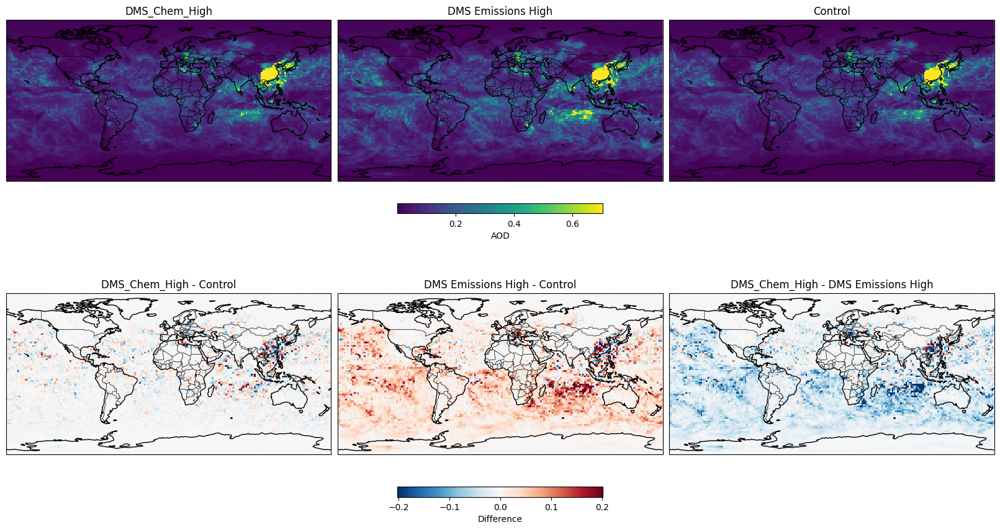

🔍 Spatial similarity between DMS_Chem_High and DMS Emissions High:
R²: 0.1018
Cosine Similarity: -0.4239
Normalized RMSE:   4.3725


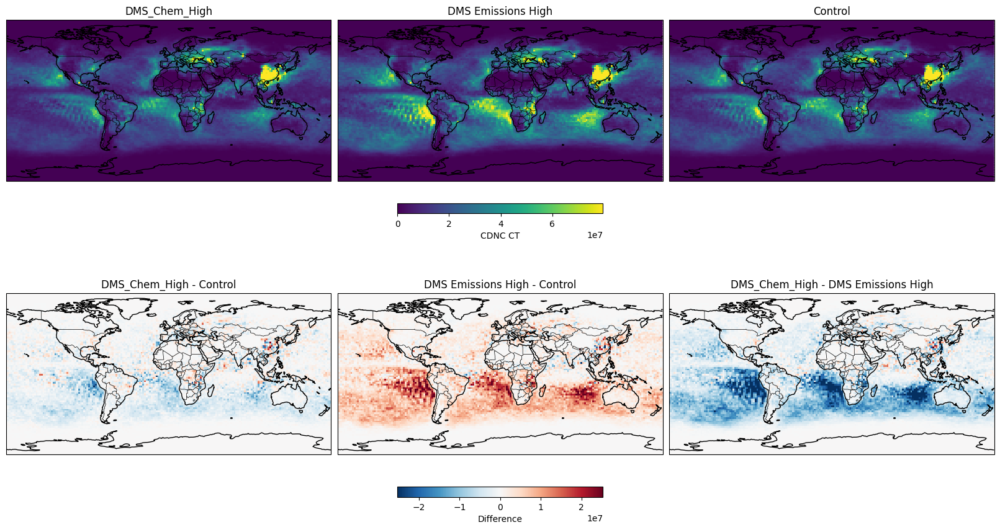

In [176]:
compare_three_experiments(
    tau_4d,
    exp1="Activate_DMS_Chem_High",
    exp2="Activate_DMS_Emissions",
    control_exp="Activate_Control",
    titles=["DMS_Chem_High", "DMS Emissions High", "Control"],
    label="AOD"
)
compare_three_experiments(
    cdnc_ct_4d,
    exp1="Activate_DMS_Chem_High",
    exp2="Activate_DMS_Emissions",
    control_exp="Activate_Control",
    titles=["DMS_Chem_High", "DMS Emissions High", "Control"],
    label="CDNC CT"
)


🔍 Spatial similarity between DMS_Chem_High and DMS Emissions High:
R²: 0.1232
Cosine Similarity: 0.2435
Normalized RMSE:   2.3387


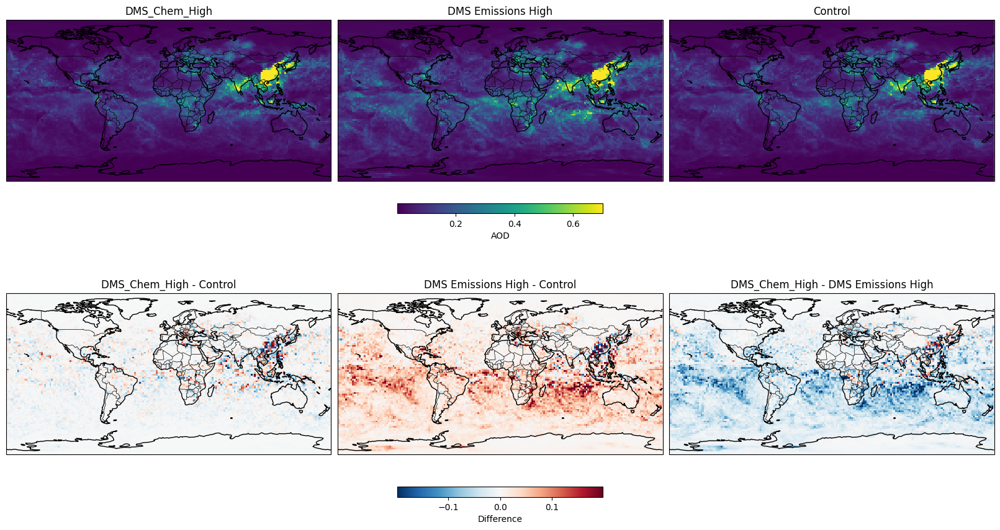

🔍 Spatial similarity between DMS_Chem_High and DMS Emissions High:
R²: 0.2213
Cosine Similarity: 0.4504
Normalized RMSE:   -6.0202


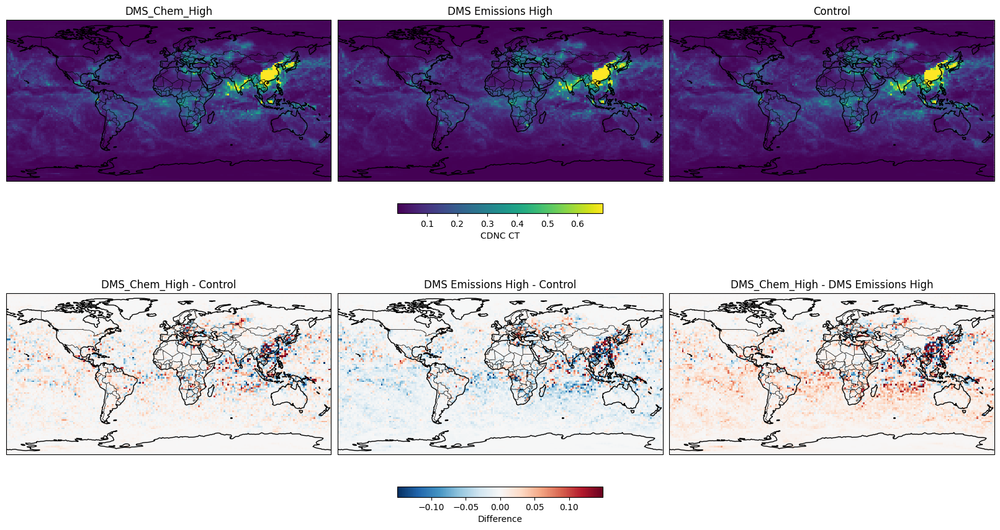

In [169]:
compare_three_experiments(
    AI,
    exp1="Activate_DMS_Chem_High",
    exp2="Activate_DMS_Emissions",
    control_exp="Activate_Control",
    titles=["DMS_Chem_High", "DMS Emissions High", "Control"],
    label="AOD"
)
compare_three_experiments(
    AI,
    exp1="Activate_DMS_Chem_Low",
    exp2="Activate_DMS_Emissions_Low",
    control_exp="Activate_Control",
    titles=["DMS_Chem_High", "DMS Emissions High", "Control"],
    label="CDNC CT"
)


🔍 Spatial similarity between DMS_Chem_Low and DMS Emissions Low:
R²: 0.2558
Cosine Similarity: 0.4955
Normalized RMSE:   -7.0443


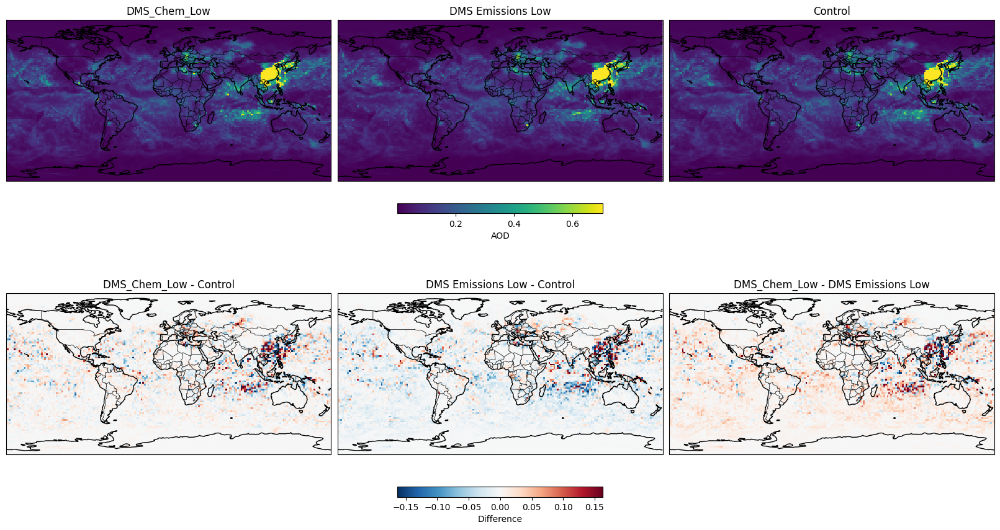

🔍 Spatial similarity between DMS_Chem_Low and DMS Emissions Low:
R²: 0.0684
Cosine Similarity: 0.1994
Normalized RMSE:   -5.0997


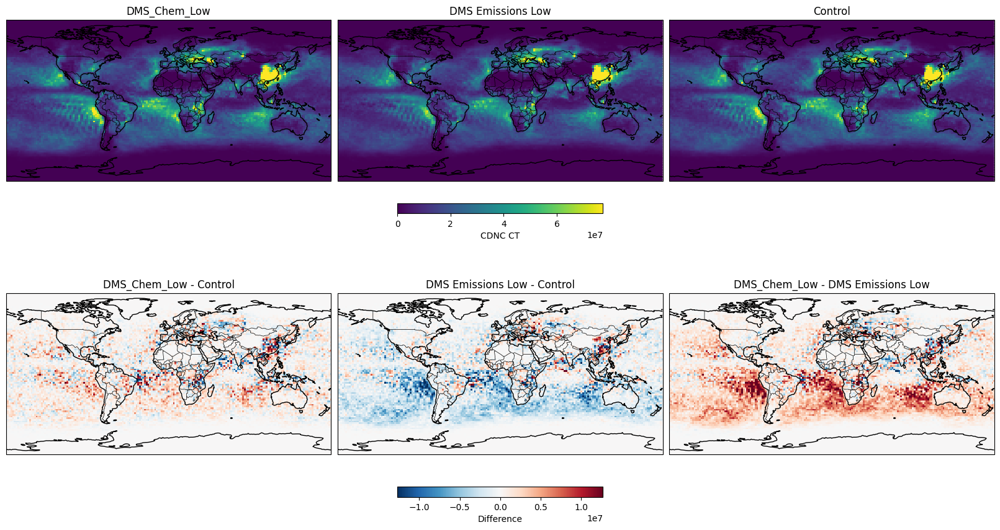

In [177]:
compare_three_experiments(
    tau_4d,
    exp1="Activate_DMS_Chem_Low",
    exp2="Activate_DMS_Emissions_Low",
    control_exp="Activate_Control",
    titles=["DMS_Chem_Low", "DMS Emissions Low", "Control"],
    label="AOD"
)
compare_three_experiments(
    cdnc_ct_4d,
    exp1="Activate_DMS_Chem_Low",
    exp2="Activate_DMS_Emissions_Low",
    control_exp="Activate_Control",
    titles=["DMS_Chem_Low", "DMS Emissions Low", "Control"],
    label="CDNC CT"
)


🔍 Spatial similarity between SSA_Coarse and SSA_ACC:
R²: 0.3470
Cosine Similarity: 0.6741
Normalized RMSE:   0.9266


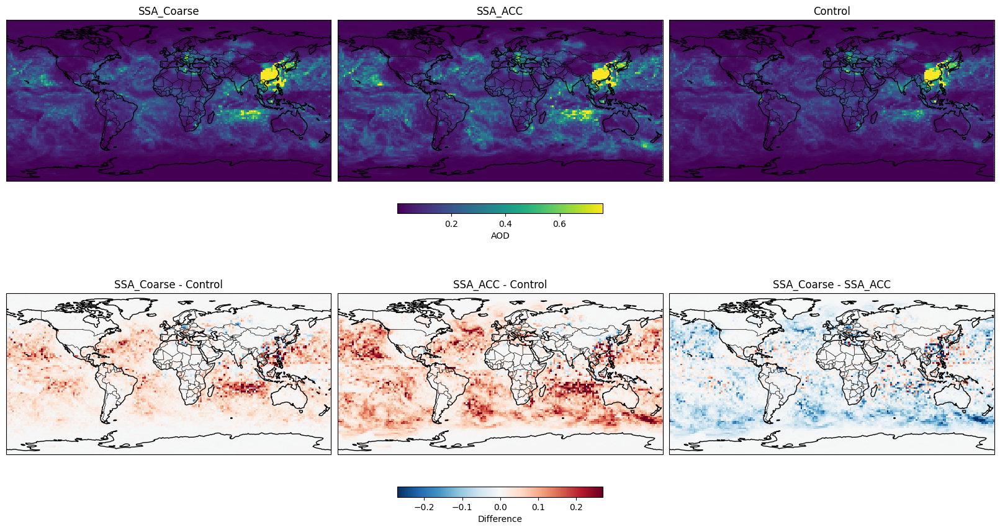

🔍 Spatial similarity between SSA_Coarse and SSA_ACC:
R²: 0.0010
Cosine Similarity: -0.0334
Normalized RMSE:   2.0982


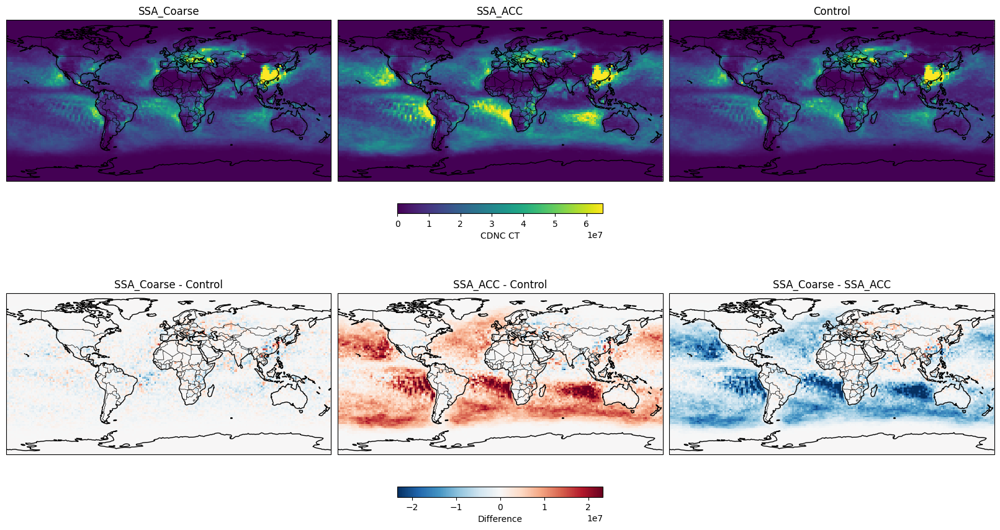

In [179]:
compare_three_experiments(
    tau_4d,
    exp1="SSA_Coarse",
    exp2="SSA_ACC",
    control_exp="Control",
    titles=["SSA_Coarse", "SSA_ACC", "Control"],
    label="AOD"
)
compare_three_experiments(
    cdnc_ct_4d,
    exp1="SSA_Coarse",
    exp2="SSA_ACC",
    control_exp="Control",
    titles=["SSA_Coarse", "SSA_ACC", "Control"],
    label="CDNC CT"
)


🔍 Spatial similarity between DMS_Emissions and SS_Emissions:
R²: 0.2931
Cosine Similarity: 0.6485
Normalized RMSE:   1.0591


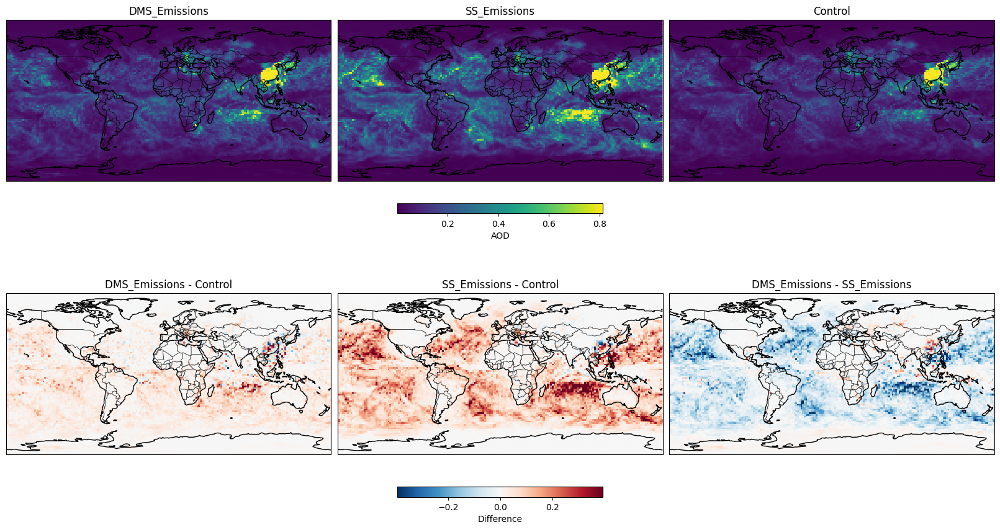

🔍 Spatial similarity between DMS_Emissions and SS_Emissions:
R²: 0.4902
Cosine Similarity: 0.7736
Normalized RMSE:   0.6896


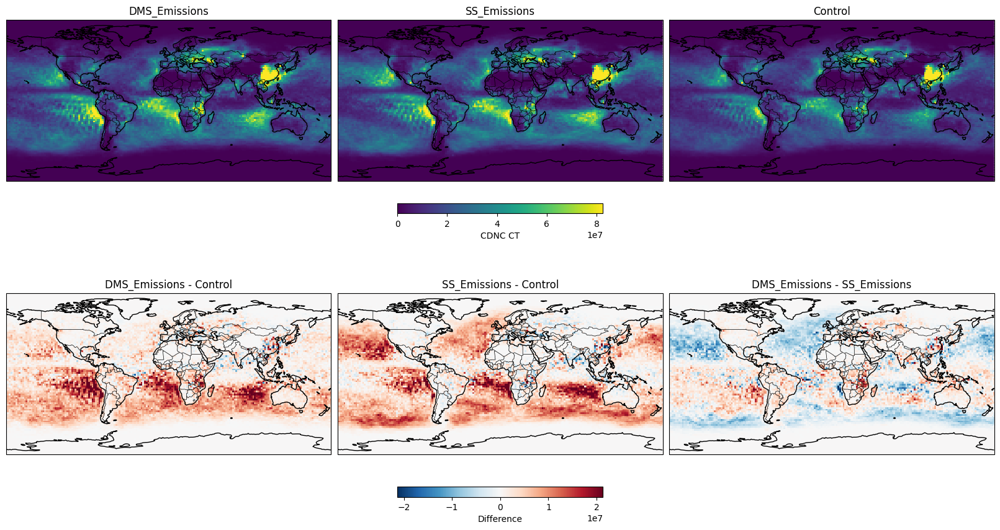

In [183]:
compare_three_experiments(
    tau_4d,
    exp1="Activate_DMS_Emissions",
    exp2="Activate_SS_Emissions",
    control_exp="Activate_Control",
    titles=["DMS_Emissions", "SS_Emissions", "Control"],
    label="AOD"
)
compare_three_experiments(
    cdnc_ct_4d,
    exp1="Activate_DMS_Emissions",
    exp2="Activate_SS_Emissions",
    control_exp="Activate_Control",
    titles=["DMS_Emissions", "SS_Emissions", "Control"],
    label="CDNC CT"
)


🔍 Spatial similarity between SS_Exponent and SS_Emissions:
R²: 0.3142
Cosine Similarity: 0.6772
Normalized RMSE:   2.0481


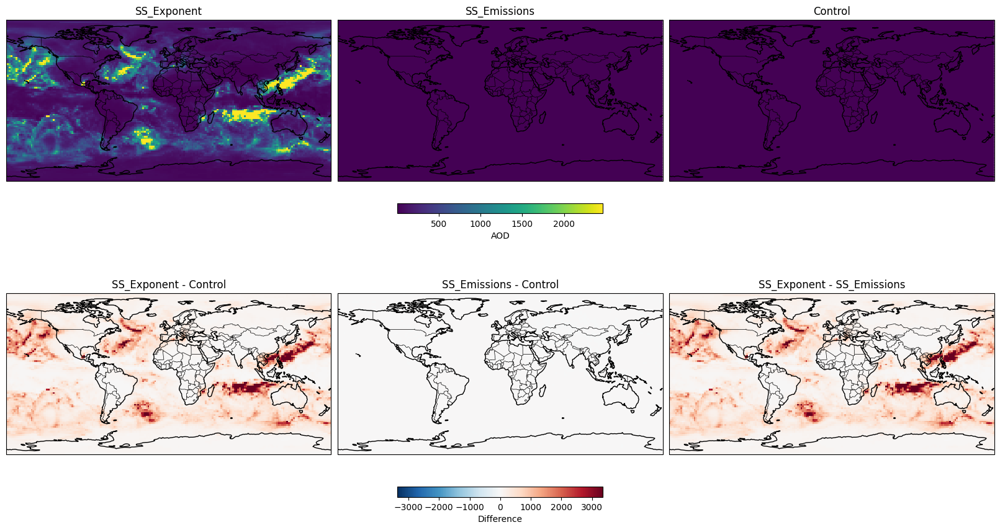

🔍 Spatial similarity between SS_Exponent and SS_Emissions:
R²: 0.3035
Cosine Similarity: 0.6761
Normalized RMSE:   1.7155


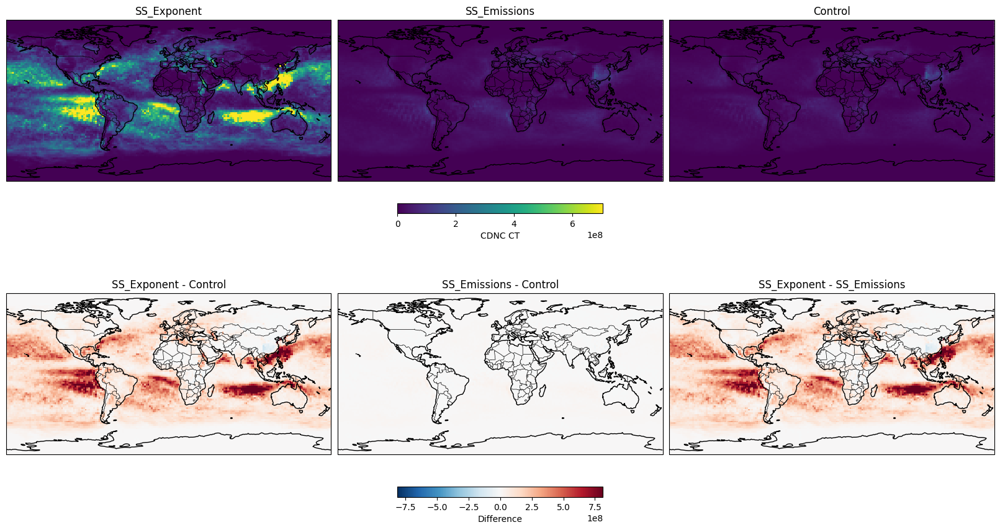

In [184]:
compare_three_experiments(
    tau_4d,
    exp1="Activate_SSA_Expo",
    exp2="Activate_SS_Emissions",
    control_exp="Activate_Control",
    titles=["SS_Exponent", "SS_Emissions", "Control"],
    label="AOD"
)
compare_three_experiments(
    cdnc_ct_4d,
    exp1="Activate_SSA_Expo",
    exp2="Activate_SS_Emissions",
    control_exp="Activate_Control",
    titles=["SS_Exponent", "SS_Emissions", "Control"],
    label="CDNC CT"
)


🔍 Spatial similarity between DMS_so2_fraction_low and DMS_so2_fraction:
R²: 0.9879
Cosine Similarity: 0.9928
Normalized RMSE:   -0.5360


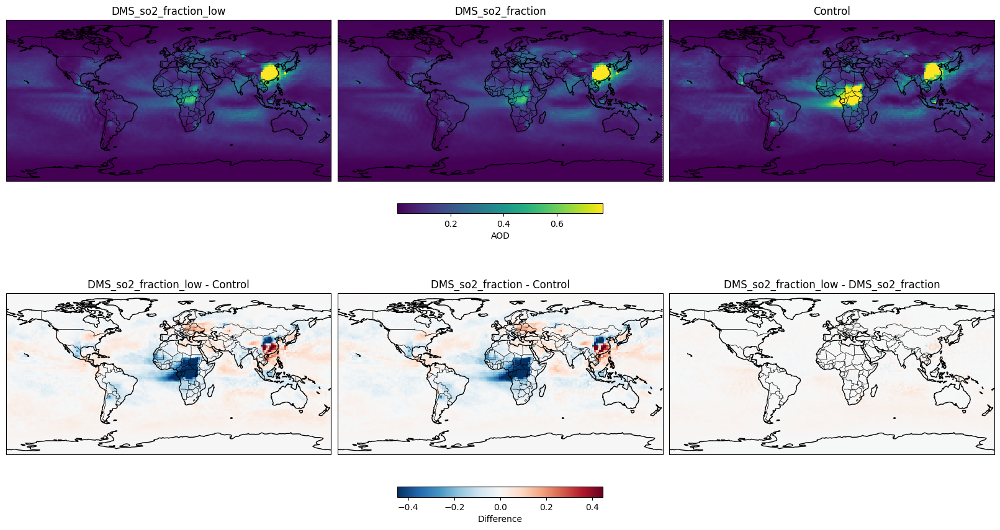

🔍 Spatial similarity between DMS_so2_fraction_low and DMS_so2_fraction:
R²: 0.5097
Cosine Similarity: 0.6425
Normalized RMSE:   4.4555


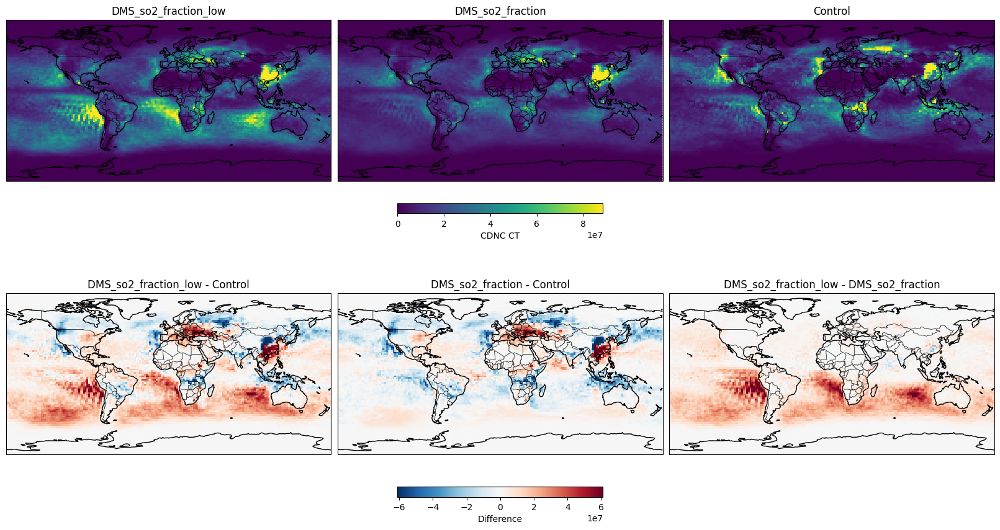

In [15]:
compare_three_experiments(
    tau_4d,
    exp1="Activate_DMS_so2_fraction_low",
    exp2="Activate_DMS_so2_fraction",
    control_exp="Activate_Control",
    titles=["DMS_so2_fraction_low", "DMS_so2_fraction", "Control"],
    label="AOD"
)
compare_three_experiments(
    cdnc_ct_4d,
    exp1="Activate_DMS_so2_fraction_low",
    exp2="Activate_DMS_so2_fraction",
    control_exp="Activate_Control",
    titles=["DMS_so2_fraction_low", "DMS_so2_fraction", "Control"],
    label="CDNC CT"
)


🔍 Spatial similarity between Activate_DMS_Chem_HIGH and Activate_DMS_Chem_Low:
R²: 0.2673
Control mean = 0.102
Activate_DMS_Chem_HIGH mean = 0.103
Activate_DMS_Chem_Low mean = 0.104


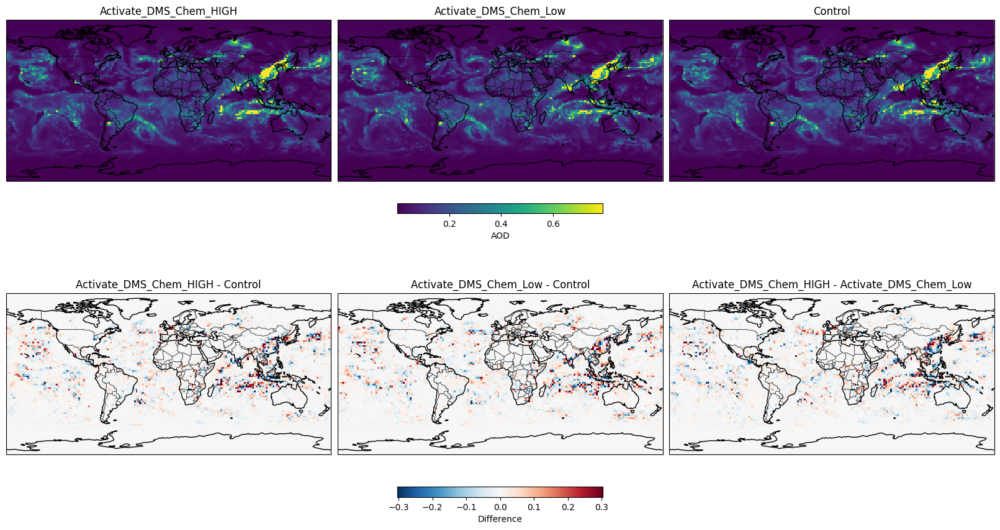

🔍 Spatial similarity between Activate_DMS_Chem_HIGH and Activate_DMS_Chem_Low:
R²: 0.2849
Control mean = 28.655
Activate_DMS_Chem_HIGH mean = 28.009
Activate_DMS_Chem_Low mean = 28.843


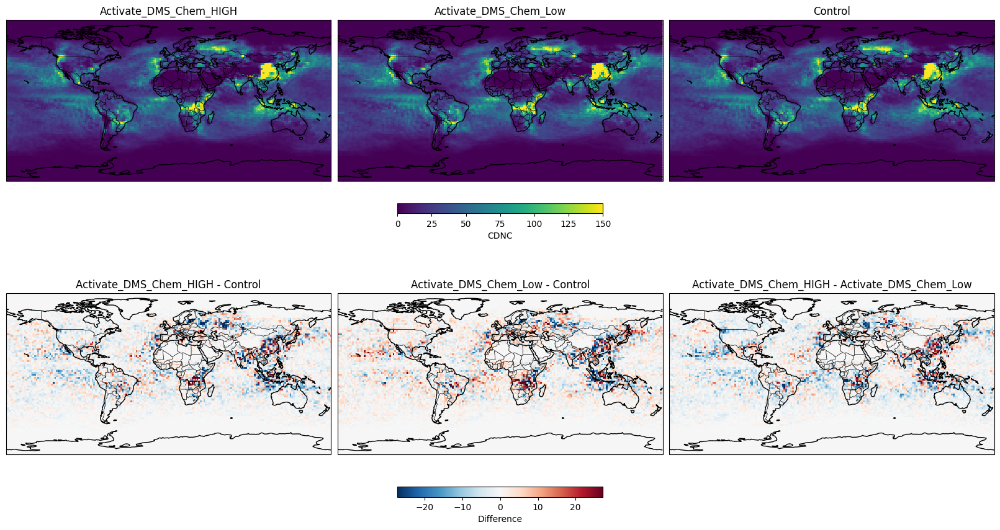

🔍 Spatial similarity between Activate_DMS_Chem_HIGH and Activate_DMS_Chem_Low:
R²: 0.2321
Control mean = 0.945
Activate_DMS_Chem_HIGH mean = 0.919
Activate_DMS_Chem_Low mean = 0.956


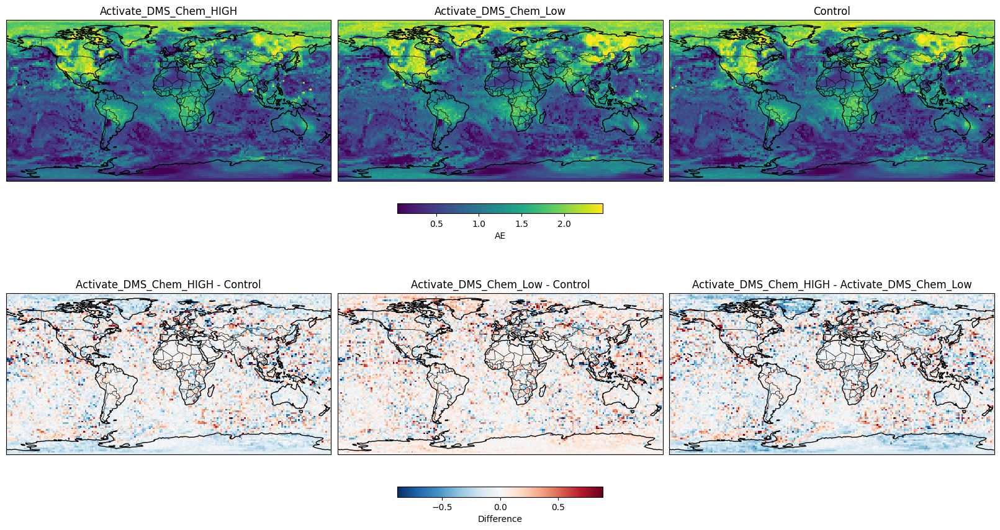

🔍 Spatial similarity between Activate_DMS_Chem_HIGH and Activate_DMS_Chem_Low:
R²: 0.9320
Control mean = 74.159
Activate_DMS_Chem_HIGH mean = 28.904
Activate_DMS_Chem_Low mean = 138.124


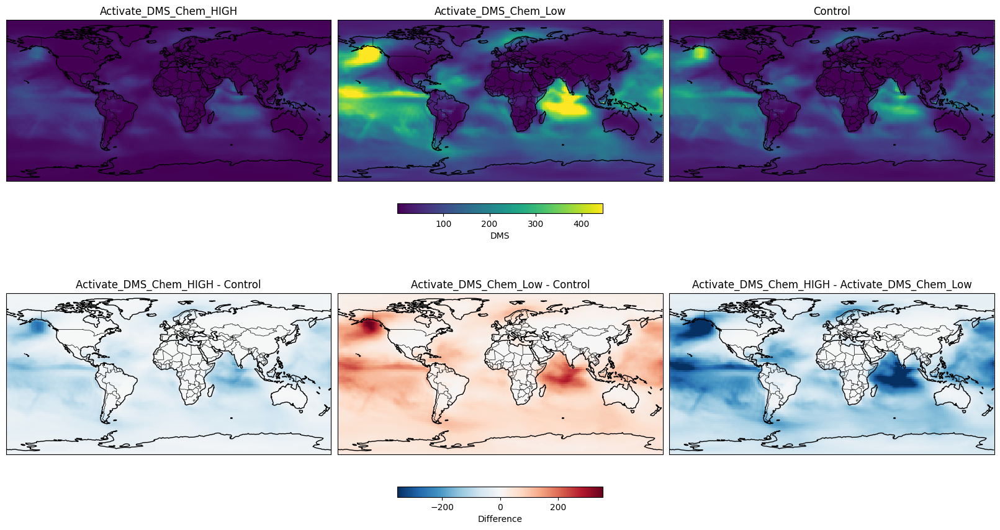

🔍 Spatial similarity between Activate_DMS_Chem_HIGH and Activate_DMS_Chem_Low:
R²: 0.0942
Control mean = 574.875
Activate_DMS_Chem_HIGH mean = 553.277
Activate_DMS_Chem_Low mean = 595.739


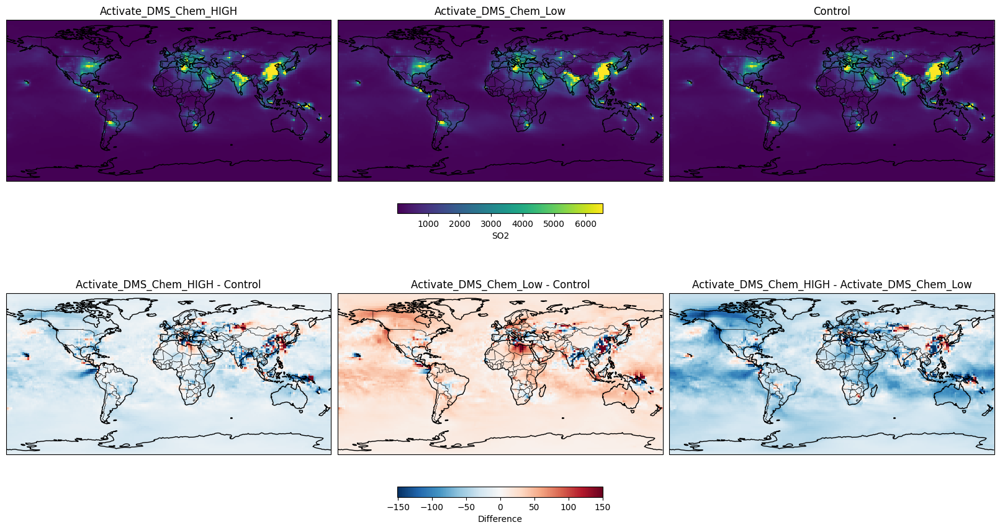

In [18]:
compare_three_experiments(
    tau_4d,
    exp1="Activate_DMS_Chem_HIGH",
    exp2="Activate_DMS_Chem_Low",
    control_exp="Control_1_month",
    titles=["Activate_DMS_Chem_HIGH", "Activate_DMS_Chem_Low", "Control"],
    label="AOD"
)
compare_three_experiments(
    cdnc_ct_4d,
    exp1="Activate_DMS_Chem_HIGH",
    exp2="Activate_DMS_Chem_Low",
    control_exp="Control_1_month",
    titles=["Activate_DMS_Chem_HIGH", "Activate_DMS_Chem_Low", "Control"],
    label="CDNC"
)

compare_three_experiments(
    ANG,
    exp1="Activate_DMS_Chem_HIGH",
    exp2="Activate_DMS_Chem_Low",
    control_exp="Control_1_month",
    titles=["Activate_DMS_Chem_HIGH", "Activate_DMS_Chem_Low", "Control"],
    label="AE"
)
compare_three_experiments(
    DMS,
    exp1="Activate_DMS_Chem_HIGH",
    exp2="Activate_DMS_Chem_Low",
    control_exp="Control_1_month",
    titles=["Activate_DMS_Chem_HIGH", "Activate_DMS_Chem_Low", "Control"],
    label="DMS"
)
compare_three_experiments(
    SO2,
    exp1="Activate_DMS_Chem_HIGH",
    exp2="Activate_DMS_Chem_Low",
    control_exp="Control_1_month",
    titles=["Activate_DMS_Chem_HIGH", "Activate_DMS_Chem_Low", "Control"],
    label="SO2"
)

🔍 Spatial similarity between Sulfate_Chem_High and Sulfate_Chem_Low:
R²: 0.1287
Control mean = 0.102
Sulfate_Chem_High mean = 0.108
Sulfate_Chem_Low mean = 0.101


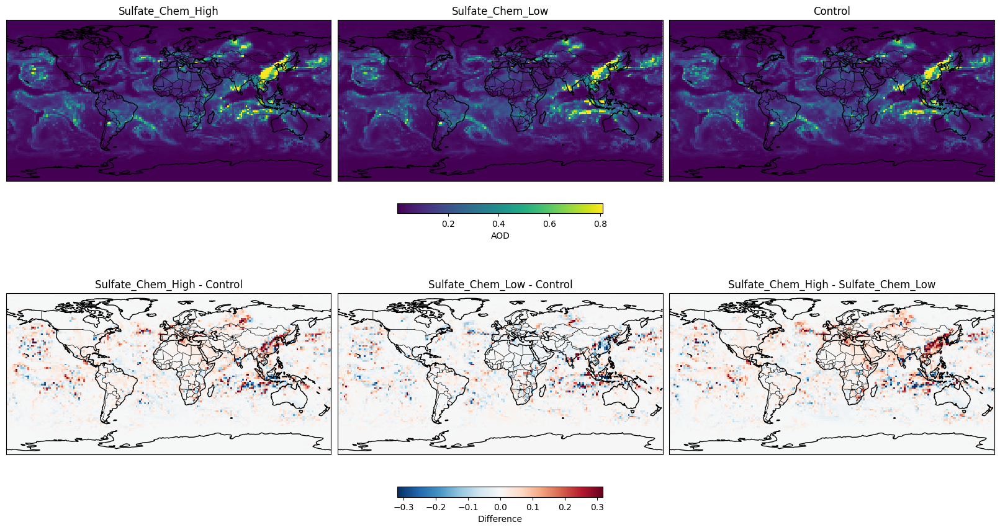

🔍 Spatial similarity between Sulfate_Chem_High and Sulfate_Chem_Low:
R²: 0.0459
Control mean = 28.655
Sulfate_Chem_High mean = 31.368
Sulfate_Chem_Low mean = 27.288


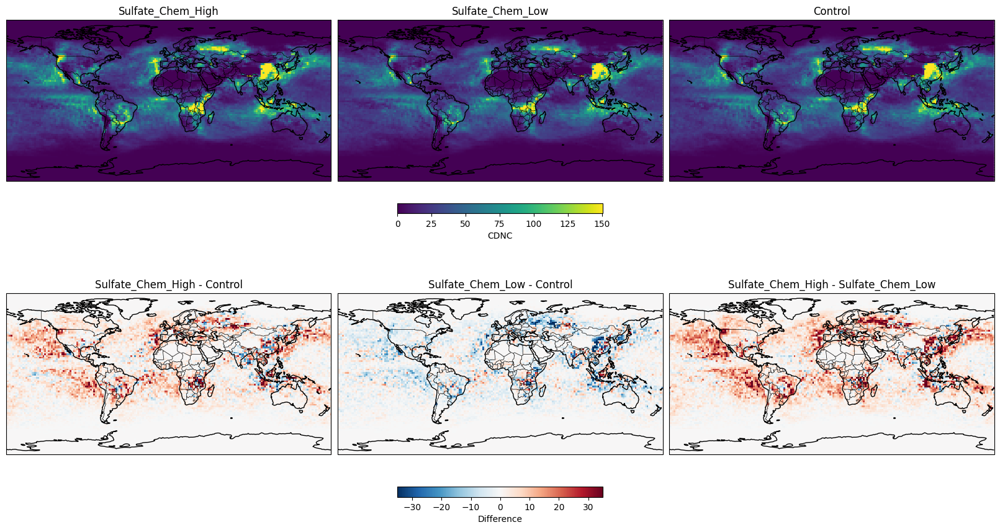

🔍 Spatial similarity between Sulfate_Chem_High and Sulfate_Chem_Low:
R²: 0.2204
Control mean = 0.945
Sulfate_Chem_High mean = 0.936
Sulfate_Chem_Low mean = 0.933


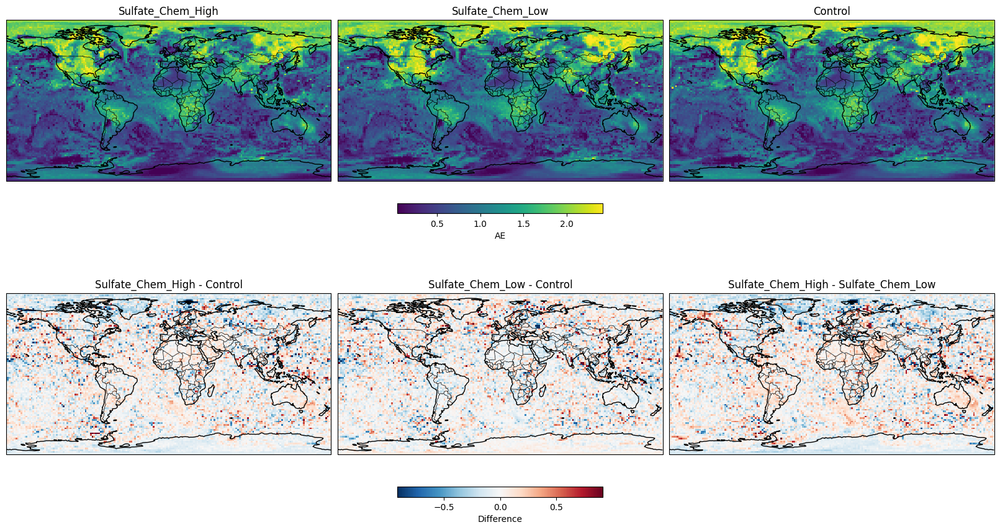

🔍 Spatial similarity between Sulfate_Chem_High and Sulfate_Chem_Low:
R²: 0.9324
Control mean = 74.159
Sulfate_Chem_High mean = 28.934
Sulfate_Chem_Low mean = 138.405


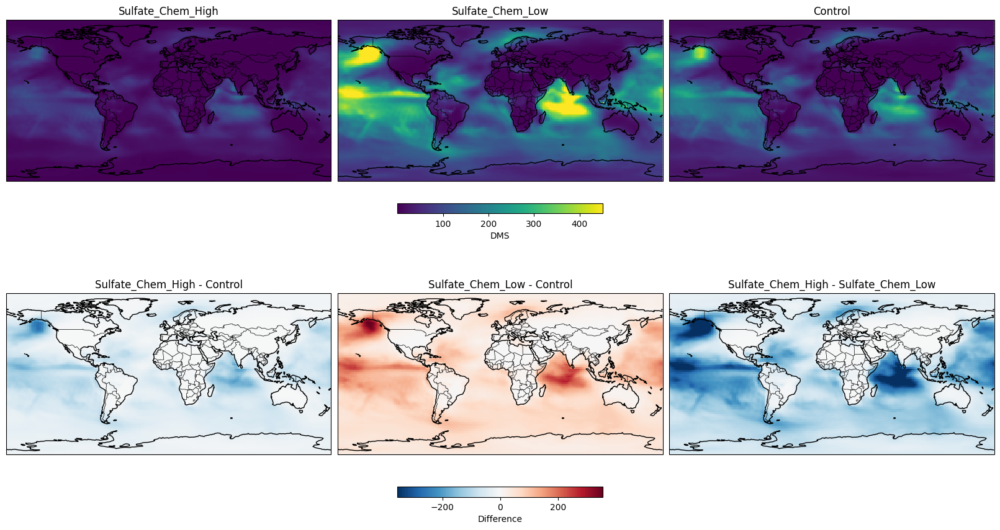

🔍 Spatial similarity between Sulfate_Chem_High and Sulfate_Chem_Low:
R²: 0.9069
Control mean = 574.875
Sulfate_Chem_High mean = 328.097
Sulfate_Chem_Low mean = 766.956


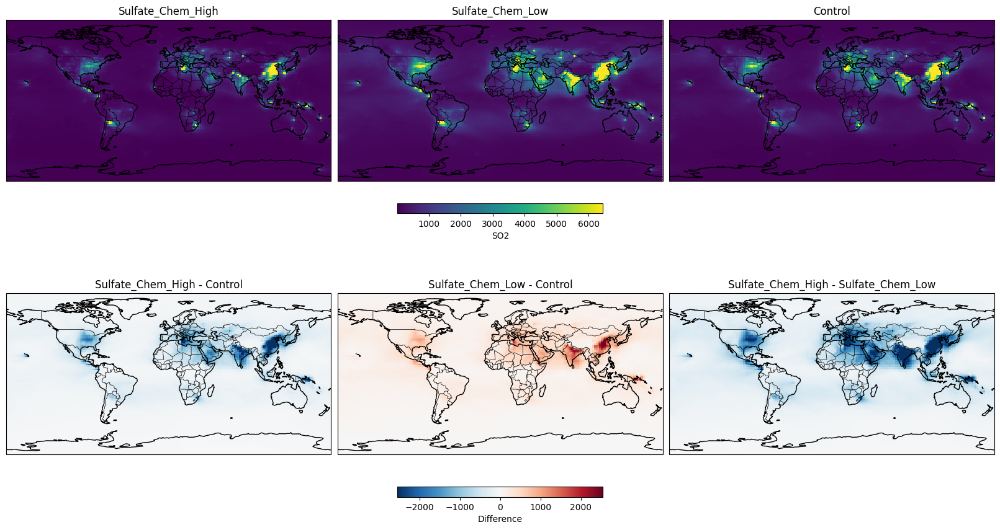

In [17]:
compare_three_experiments(
    tau_4d,
    exp1="Sulfate_Chem_High",
    exp2="Sulfate_Chem_Low",
    control_exp="Control_1_month",
    titles=["Sulfate_Chem_High", "Sulfate_Chem_Low", "Control"],
    label="AOD"
)
compare_three_experiments(
    cdnc_ct_4d,
    exp1="Sulfate_Chem_High",
    exp2="Sulfate_Chem_Low",
    control_exp="Control_1_month",
    titles=["Sulfate_Chem_High", "Sulfate_Chem_Low", "Control"],
    label="CDNC"
)

compare_three_experiments(
    ANG,
    exp1="Sulfate_Chem_High",
    exp2="Sulfate_Chem_Low",
    control_exp="Control_1_month",
    titles=["Sulfate_Chem_High", "Sulfate_Chem_Low", "Control"],
    label="AE"
)
compare_three_experiments(
    DMS,
    exp1="Sulfate_Chem_High",
    exp2="Sulfate_Chem_Low",
    control_exp="Control_1_month",
    titles=["Sulfate_Chem_High", "Sulfate_Chem_Low", "Control"],
    label="DMS"
)
compare_three_experiments(
    SO2,
    exp1="Sulfate_Chem_High",
    exp2="Sulfate_Chem_Low",
    control_exp="Control_1_month",
    titles=["Sulfate_Chem_High", "Sulfate_Chem_Low", "Control"],
    label="SO2"
)